# DeepGIS Mask RCNN training and inference code

Please run this colab notebook with a GPU support if you are training the network. 
If you are here to download the masks, please do that without GPU.

# Download Data

### Use Google Drive to store the weights from Mask RCNN

Skip this step, if you are here to create the numpy masks.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Remove any previous contents in the colab directory

In [3]:
! rm -rf json/ labels/ images/ dataset.zip sample_data

### Download the image annotations from DeepGIS.

You can generate dataset by clicking the Deep Learning Zoo/Mask RCNN option (left side) of DeepGIS. This will create generate a link similar to 
https://project_name.deepgis.org/media/labels/harish/iKRvgHFmrWuDHppM/dataset.zip

Example shown here is that of LROC NAC image dataset, you can replace the url with your annotations in DeepGIS

In [4]:
! wget https://lroc-nac.deepgis.org/media/labels/harishanand77/qBtoVBUHtyvMaZCo/dataset.zip

--2021-01-19 19:43:52--  https://lroc-nac.deepgis.org/media/labels/harishanand77/qBtoVBUHtyvMaZCo/dataset.zip
Resolving lroc-nac.deepgis.org (lroc-nac.deepgis.org)... 129.219.113.11
Connecting to lroc-nac.deepgis.org (lroc-nac.deepgis.org)|129.219.113.11|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7649053 (7.3M) [application/zip]
Saving to: ‘dataset.zip’

dataset.zip         100%[===================>]   7.29M  10.4MB/s    in 0.7s    

2021-01-19 19:43:53 (10.4 MB/s) - ‘dataset.zip’ saved [7649053/7649053]



### Unzip the dataset.zip file. 
There will be two folders json/ and images/

In [5]:
! unzip -qq dataset.zip

# Import libraries

### Convert DeepGIS json annotations to numpy masks

In [6]:
! pip install wand
! apt-get update && apt-get install libmagickwand-dev -y -q

     |████████████████████████████████| 143kB 19.6MB/s 
Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Get:2 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Ign:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Hit:5 http://archive.ubuntu.com/ubuntu bionic InRelease
Ign:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:8 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:10 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Get:11 http://security.ubuntu.com/ubuntu bionic-security/universe amd64 Packages [1,381 kB]
Get:12 http://sec

In [7]:
import os
import json
import re
import numpy as np
from wand.image import Image as WandImage
from wand.color import Color as WandColor
import io
import imageio
from bs4 import BeautifulSoup
import torch
from PIL import Image
import pickle
import cv2

In [8]:
def image_string_to_SVG_string_file(svgStr):
    SVG_string_file = io.StringIO(svgStr)
    SVG_string_file.seek(0)
    return SVG_string_file.read().encode('utf-8')

def image_label_string_to_SVG_string(DBStr, height=None, width=None, x=0, y=0, keepImage=False):
    addedStr = DBStr
    #get the image path
    imagePath = ""
    imageString = ""
    if keepImage:
        imagePath = re.search('ns1:href="(.*)png"', DBStr)
        try:
            imagePath = imagePath.group(1)+"png"
        except AttributeError as e:
            imagePath = re.search('a0:href="(.*)png"', DBStr)
            imagePath = imagePath.group(1) + "png"

        imageWidth = re.search(r'width="(\d+)"', addedStr).group(1)
        imageHeight = re.search(r'height="(\d+)"', addedStr).group(1)

        imageString = '<defs><pattern id="backgroundImage" ' \
        'patternUnits="userSpaceOnUse" width="%s" height="%s">' \
        '<image xlink:href="%s" x="-%s" y="-%s" width="%s" height="%s"/>' \
        '</pattern></defs><rect id="background" fill="url(#backgroundImage)" '\
        'width="%s" height="%s"/>' % (width, height, imagePath, x, y, imageWidth, imageHeight, width, height)

    if height == None or width == None:
        image, height, width = SVGDimensions(DBStr)
        if not keepImage and image:
            addedStr = DBStr.replace(image, '')

    addedStr = re.sub(r'<image.+hidden"/>', '', addedStr)
    addedStr = addedStr.encode('utf-8')
    return '<?xml version="1.0" encoding="UTF-8" standalone="no"?>' \
           '<svg version="1.1" id="Layer_1" xmlns="http://www.w3.org/2000/svg"' \
           ' xmlns:xlink="http://www.w3.org/1999/xlink" x="0px" y="0px" xml:space="preserve" height="%s"' \
           ' width="%s">%s%s</svg>' % (height, width, imageString, addedStr)


## Remove existing labels

In [21]:
! rm -rf labels

## Convert svg annotations to numpy masks (Height, Width, Masks)

In [22]:
IMAGE_FILE_EXTENSION = ".png"
TOTAL_COUNT = 0
CATEGORY_NAMES = None
json_files = os.listdir('json/')

if not os.path.exists('labels/'):
    os.makedirs('labels/')

for json_file in json_files:
  with open('json/' + json_file) as f:
    data = json.load(f)
  
  outputFilenameNpy = 'labels/' + json_file[:-4] + 'npy'
  height = data["height"]
  width = data["width"]
  ctr = 0
  total_paths = 1000
  masks_ndarray = np.zeros((total_paths, height, width), dtype=np.int8)

  CATEGORY_NAMES = data["categories"]

  for id, element in data["labelShapes"]:
    if id == 2: # skip rocks
      print(data["categories"][id])
      continue
    category_id = id
    svg = element
    paths = []
    poly = []
    soup = BeautifulSoup(svg)
    circles = soup.find_all('circle')
    # poly = soup.find_all('polygon') AI predictions avoided in LROC NAC
    paths = soup.find_all('path')
    ellipse = soup.find_all('ellipse')
    shapes = paths + circles + ellipse
    TOTAL_COUNT += len(shapes)
    
    if len(paths) + len(circles) + len(ellipse) > 0:
      for idx, path in enumerate(shapes):
        img=WandImage(blob=image_string_to_SVG_string_file(image_label_string_to_SVG_string(str(path),height,width)))
        img.resize(width, height)
        img.background_color = WandColor('white')
        img.alpha_channel = 'remove'
        img.negate()
        img.threshold(0)
        img.format = 'png'

        outputFilename = ('labels/' + json_file[:-4] + 'png')

        img.save(filename=outputFilename)
        im = imageio.imread(outputFilename)

        masks = np.array(im)
        cat_mask = np.where(masks == 255, category_id , masks)

        if cat_mask.max() != 0:
          cat_mask_check = cat_mask > 0
          cat_mask_check = cat_mask_check.astype(np.uint8)
          pos = np.where(cat_mask_check)
          xmin = np.min(pos[1])
          xmax = np.max(pos[1])
          ymin = np.min(pos[0])
          ymax = np.max(pos[0])
          if xmin < xmax and ymin < ymax:
            masks_ndarray[ctr, :, :] = cat_mask
            ctr = ctr + 1
          else:
            print("failed")
            # print(ctr)
  print(outputFilenameNpy, ctr)

# MaskRCNN pytorch version wont handle images without labels
  if ctr == 0:
    masks_ndarray[0, :, :] = np.zeros((height, width))
    print("NO MASKS FOUND") 
    ctr = 1
    continue
  
  #print(ctr)
  masks_ndarray.resize(ctr, height, width)
  masks_ndarray = masks_ndarray.transpose(1, 2, 0)

  np.save(outputFilenameNpy, masks_ndarray)

  for rmfile in os.listdir('labels/'):
      if rmfile.endswith('.png'):
          os.remove('labels/' + rmfile)    

labels/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_8050_8050_0_056.npy 38
rock
labels/_static_brent_M1323614830_4_tile_350_3500_0_0127.npy 448
rock
labels/_static_brent_M1206026628LE_2_tile_700_1661_0_096.npy 420
rock
labels/_static_M1348265832LE_tile_0_25200_0_022.npy 111
rock
labels/_static_M1348265832LE_tile_0_22050_0_029.npy 249
labels/_static_brent_M1190722935RE_1_tile_997_1050_0_073.npy 44
rock
labels/_static_M1348265832LE_tile_0_16450_0_016.npy 193
failed
rock
labels/_static_brent_M181180684LE_3_tile_350_0_0_0121.npy 573
rock
labels/_static_M1348265832LE_tile_0_20300_0_058.npy 104
rock
labels/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_20300_10150_0_0120.npy 279
rock
labels/_static_brent_M1206026628LE_3_tile_700_0_0_0134.npy 498
labels/_static_NAC_ROI_APENNINELOB_E254N0008_tile_700_36050_0_070.npy 236
labels/_static_brent_M1323614830_4_tile_700_1750_0_084.npy 257
rock
labels/_static_M1348265832LE_tile_0_17150_0_015.npy 203
rock
labels/_static_brent_M1335362659LE_3_tile_1126_1400_0

In [23]:
TOTAL_COUNT

36468

## Zip the labels and images ( and download them?)

In [24]:
! zip -r archive.zip images labels

  adding: images/ (stored 0%)
  adding: images/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_7000_5600_0_0128.png (deflated 0%)
  adding: images/_static_NAC_ROI_APENNINELOB_E254N0008_tile_1400_33250_0_0102.png (deflated 0%)
  adding: images/_static_brent_M1190722935RE_4_tile_975_1050_0_0140.png (deflated 0%)
  adding: images/_static_M1348265832LE_tile_0_7000_0_011.png (deflated 0%)
  adding: images/_static_M1348265832LE_tile_0_20300_0_058.png (deflated 0%)
  adding: images/_static_brent_M1190722935RE_4_tile_700_2800_0_083.png (deflated 0%)
  adding: images/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_8750_38500_0_036.png (deflated 0%)
  adding: images/_static_NAC_ROI_APENNINELOB_E254N0008_tile_1750_16800_0_067.png (deflated 0%)
  adding: images/_static_brent_M1323614830_4_tile_700_1750_0_084.png (deflated 0%)
  adding: images/_static_brent_M181180684LE_3_tile_701_1239_0_0133.png (deflated 0%)
  adding: images/_static_NAC_ROI_APENNINELOB_E254N0008_tile_700_33950_0_0144.png (deflated 0%)
  ad

## Display all the categories

First element should be background.
Rest are the categories labeled.

In [27]:
CATEGORY_NAMES = ['background', 'crater']
print(CATEGORY_NAMES)

['background', 'crater']


### Import libraries for plotting the numpy masks

In [28]:
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.image as mpimg

### Select a file and plot the masks


In [29]:
mask_files = os.listdir('labels/')
mask_file = 'labels/' + mask_files[0]

Opening mask file labels/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_9100_5600_0_065.npy


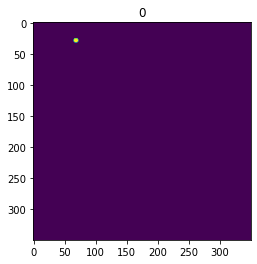

In [30]:
print("Opening mask file " + mask_file)

mask = np.load(mask_file)  

for i in range(mask.shape[2]):
  plt.figure()
  plt.imshow(mask[:, :, i])
  plt.title(str(i))
  break

### Overlay one of the image annotation on top of the image to validate the annotations

(350, 350)


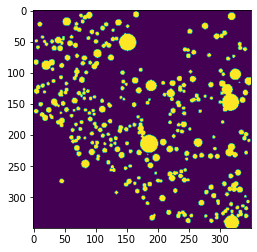

In [31]:
mask = np.load(mask_file)
image = mask.any(axis=2)
print(image.shape)
plt.imshow(image)
plt.imsave('name.png', image)

Image file is images/_static_NAC_ROI_ALPHNSUSLOA_E129S3581_tile_9100_5600_0_065.png


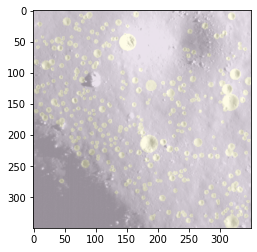

In [34]:
img = Image.open("name.png").convert("RGBA")
corresponding_image_file = "images/"  + mask_files[0].split(".")[0] + ".png"
print("Image file is " + corresponding_image_file)
background = Image.open(corresponding_image_file).convert("RGBA")

background.putalpha(64)
background.paste(img, (0, 0), background)
background.save('superimpose.png',"PNG")
img = mpimg.imread('superimpose.png')
imgplot = plt.imshow(img)



### Data augmentation

This code may be **skipped** for LROC NAC dataset.
Make sure to have enough space on Colab disk if you do augmentation. Typically this will result in very low disk space in Colab workspace desktop. 

Example location with Google Drive as storage

Images: /content/drive/My Drive/flow_dataset/images/

Labels: /content/drive/My Drive/flow_dataset/labels/

If you do use the data augmentation, make sure to correctly mention the locations of the images and labels for the code after this section.

In [1]:
# Create trained_param_fish_v1 folder in google drive
! mkdir /content/drive/My\ Drive/flow_dataset/

mkdir: cannot create directory ‘/content/drive/My Drive/flow_dataset/’: No such file or directory


In [ ]:
! mv /content/images /content/drive/My\ Drive/flow_dataset/
! mv /content/labels /content/drive/My\ Drive/flow_dataset/

In [ ]:
from shutil import copyfile
files = os.listdir('/content/drive/My Drive/flow_dataset/labels/')
for i in range(2):
  for f in files:
      # copyfile('./labels/'+f, './labels/'+str(i)+"_"+f)
      img = np.load('/content/drive/My Drive/flow_dataset/labels/'+f)
      img = np.flip(img, i) # 0 is up-down flip
      np.save('/content/drive/My Drive/flow_dataset/labels/'+str(i)+"_"+f, img)


files = os.listdir('/content/drive/My Drive/flow_dataset/images/')
for i in range(2):
  for f in files:
      #copyfile('./images/'+f, './images/'+str(i)+"_"+f)
      if i == 0:
        src = cv2.imread('/content/drive/My Drive/flow_dataset/images/'+f)
        dest = cv2.flip(src, 1) # 1 is up-down flip
        cv2.imwrite('/content/drive/My Drive/flow_dataset/images/'+str(1)+"_"+f, dest) 
      else:
        src = cv2.imread('/content/drive/My Drive/flow_dataset/images/'+f)
        dest = cv2.flip(src, 0) 
        cv2.imwrite('/content/drive/My Drive/flow_dataset/images/'+str(0)+"_"+f, dest)      

### Import libraries

In [35]:
! wget https://raw.githubusercontent.com/pytorch/vision/master/references/detection/engine.py 
! wget https://raw.githubusercontent.com/DREAMS-lab/mask_rcnn_pytorch/master/visualize.py
! wget https://raw.githubusercontent.com/pytorch/vision/master/references/detection/coco_eval.py
! wget https://raw.githubusercontent.com/pytorch/vision/master/references/detection/coco_utils.py
! wget https://raw.githubusercontent.com/pytorch/vision/master/references/detection/transforms.py
! wget https://raw.githubusercontent.com/pytorch/vision/master/references/detection/utils.py

--2021-01-19 21:23:01--  https://raw.githubusercontent.com/pytorch/vision/master/references/detection/engine.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3699 (3.6K) [text/plain]
Saving to: ‘engine.py’

engine.py           100%[===================>]   3.61K  --.-KB/s    in 0s      

2021-01-19 21:23:01 (73.4 MB/s) - ‘engine.py’ saved [3699/3699]

--2021-01-19 21:23:01--  https://raw.githubusercontent.com/DREAMS-lab/mask_rcnn_pytorch/master/visualize.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15111 (15K) [text/plain]
Saving to:

In [36]:
from engine import train_one_epoch, evaluate
import torch
from PIL import Image
import pickle
import cv2
import os
import numpy as np
import torch.nn as nn
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
from torchvision.models.detection.rpn import AnchorGenerator
from visualize import display_instances

# Mask RCNN Dataset

In [37]:
class Dataset(object):
    def __init__(self, image_path, label_path, transforms=None, savePickle=True, readsave=True, include_name=True):
        self.image_path = image_path
        self.label_path = label_path
        self.transforms = transforms
        self.images = [f for f in os.listdir(image_path) if f.endswith(".png")]
        self.masks = [f for f in os.listdir(label_path) if f.endswith(".npy")]
        self.include_name = include_name
        self.savePickle = savePickle
        self.__refine(readsave)


    def __refine(self, readsave):
        if not readsave:
            images = []
            masks = []
            for img in self.images:
                frame = img[:-4]
                mask = frame + ".npy"
                if mask in self.masks:
                    mask_path = os.path.join(self.label_path, mask)
                    mask_nd = np.load(mask_path)
                    if mask_nd.max() > 0:
                        images.append(img)
                        masks.append(mask)

            self.images = images
            self.masks = masks
            data = {"images": images, "masks": masks,}
            if self.savePickle:
                with open('data.pickle', 'wb') as filehandle:
                    pickle.dump(data, filehandle)
        else:
            with open('data.pickle', 'rb') as filehandle:
                data = pickle.load(filehandle)
                self.images = data["images"]
                self.masks = data["masks"]
    
    def __getitem(self, idx):
        img_path = os.path.join(self.image_path, self.images[idx])
        mask_path = os.path.join(self.label_path, self.masks[idx])

        image = Image.open(img_path).convert("RGB")
        # In training, 0 is of background
        masks = np.load(mask_path)
        masks = masks.astype(np.uint8)
        num_objs = masks.shape[2]
        labels = []
        for i in range(num_objs):
          labels.append(masks[:,:, i].max())
        obj_ids = np.array(labels)
        boxes = []
        for i in range(num_objs):
            pos = np.where(masks[:, :, i])
            xmin = np.min(pos[1])
            xmax = np.max(pos[1])
            ymin = np.min(pos[0])
            ymax = np.max(pos[0])
            boxes.append([xmin, ymin, xmax, ymax])

        # convert everything into a torch.Tensor
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(obj_ids, dtype=torch.int64)
        
        masks = masks > 0  # convert to binary masks
        masks = masks.astype(np.uint8)
        masks = torch.as_tensor(masks, dtype=torch.uint8)
        masks = masks.permute((2, 0, 1))

        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)
        
        keep = (boxes[:, 3] > boxes[:, 1]) & (boxes[:, 2] > boxes[:, 0])
        boxes = boxes[keep]
        labels = labels[keep]
        masks = masks[keep]
        area = area[keep]
        iscrowd = iscrowd[keep]
        
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["masks"] = masks
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.include_name:
            target["image_name"] = img_path

        if self.transforms is not None:
            image, target = self.transforms(image, target)
        return image, target

    def __getitem__(self, idx):
        return self.__getitem(idx)

    def __len__(self):
        return len(self.images)

    def display(self, idx):
        image, target = self.__getitem__(idx)
        #image = image.permute((1, 2, 0))
        #image = (image.numpy() * 255).astype(np.uint8)
        #image = Image.fromarray(image)
        image.show()

        masks = target["masks"]
        masks = masks.permute((1, 2, 0))
        masks = masks.numpy()
        masks = masks.max(axis=2) * 255
        masks = Image.fromarray(masks)
        masks.show()

    def imageStat(self):
        images = np.empty((0, 3), float)
        for data_file in self.images:
            data_path = os.path.join(self.image_path, data_file)
            data = cv2.imread(data_path)
            image = data.astype(float).reshape(-1, 3)/255.0
            images = np.append(images, image, axis=0)
        return np.mean(images, axis=0).tolist(), np.std(images, axis=0).tolist(), \
               np.max(images, axis=0).tolist(), np.min(images, axis=0).tolist()

### Define transform code

In [38]:
class Compose(object):
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, target):
        for t in self.transforms:
            image, target = t(image, target)
        return image, target

class ToTensor(object):
    def __call__(self, image, target):
        image = np.array(image)
        image = torch.from_numpy(image / 255.0).float()
        image = image.permute((2, 0, 1))
        return image, target

def get_transform(train):
    transforms = []
    transforms.append(ToTensor()) 
    return Compose(transforms)

def get_mean_std(input_channel, image_mean, image_std):
    if input_channel == 8:
        return image_mean, image_std
    elif input_channel == 3:
        return image_mean[:3], image_std[:3]
    elif input_channel == 5:
        return image_mean[:5], image_std[:5]
    elif input_channel == 6:
        return image_mean[:3] + image_mean[-3:], image_std[:3] + image_mean[-3:]
    elif input_channel == 4:
        return image_mean[:3] + [np.mean(image_mean[-3:]).tolist()], image_std[:3] + [np.mean(image_std[-3:]).tolist()]
    elif input_channel == 'dem':
        return image_mean[-3:], image_std[-3:]

def collate_fn(batch):
    return tuple(zip(*batch))

In [39]:
def get_model_instance_segmentation(num_classes, image_mean, image_std, stats=False):
    # load an instance segmentation model pre-trained pre-trained on COCO
    #model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # the size shape and the aspect_ratios shape should be the same as the shape in the loaded model
    anchor_generator = AnchorGenerator(sizes=((32,), (64,), (128,), (256,), (512,)),
                                       aspect_ratios=((0.5, 1.0, 2.0), (0.5, 1.0, 2.0), (0.5, 1.0, 2.0), (0.5, 1.0, 2.0), (0.5, 1.0, 2.0)))
    model.rpn.anchor_generator = anchor_generator

    if stats:
        model.transform.image_mean = image_mean
        model.transform.image_std = image_std
    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)
    model.roi_heads.detections_per_img = 256

    return model

# Train Network

#### Split Dataset into train, validation and test

train 60% 

val 20%

test 20%

Labels are in labels/

Images are in images/

In [40]:
! mkdir -p train_data/images train_data/labels test_data/images test_data/labels val_data/images val_data/labels

In [41]:
from math import floor
mask_files = os.listdir('labels/')

split_index = int(floor(len(mask_files)*0.6))

train_data = mask_files[:split_index]
test_val_data = mask_files[split_index:]

split_index = int(floor(len(mask_files)*0.2))
val_data = test_val_data[:split_index]
test_data = test_val_data[split_index:]

for file_name in train_data:
  png_file = file_name.split('.')[0] + ".png"
  os.system(f"mv labels/{file_name} train_data/labels/")
  os.system(f"mv images/{png_file} train_data/images/")

for file_name in test_data:
  png_file = file_name.split('.')[0] + ".png"
  os.system(f"mv labels/{file_name} test_data/labels/")
  os.system(f"mv images/{png_file} test_data/images/")

for file_name in val_data:
  png_file = file_name.split('.')[0] + ".png"
  os.system(f"mv labels/{file_name} val_data/labels/")
  os.system(f"mv images/{png_file} val_data/images/")

# Train Network

### Load device

In [43]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)  # make sure you have cuda for training


cuda


### Load data

In [ ]:
# CATEGORY_NAMES = ['background', 'crater']
# num_classes = len(CATEGORY_NAMES)

In [42]:
train_dataset = Dataset("./train_data/images/", "./train_data/labels/", transforms=get_transform(train=True), readsave=False, include_name=False)
val_dataset = Dataset("./val_data/images/", "./val_data/labels/", transforms=get_transform(train=True), readsave=False, include_name=False)


image_mean, image_std, _, _ = train_dataset.imageStat()  # get mean and std if you don't know
print(image_mean)
print(image_std)


data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=1, shuffle=True, num_workers=8,
    collate_fn=collate_fn)


val_data_loader = torch.utils.data.DataLoader(
    val_dataset, batch_size=1, shuffle=True, num_workers=8,
    collate_fn=collate_fn)

[0.38018785017103623, 0.38018785017103623, 0.38018785017103623]
[0.16902564867195058, 0.16902564867195058, 0.16902564867195058]


### Create a directory inside Google Drive to save the checkpoints

In [53]:
foldername = "trained_param_lroc_nac_v1_jan19"

In [54]:
# Create trained_param_fish_v1 folder in google drive
! mkdir /content/drive/My\ Drive/trained_param_lroc_nac_v1_jan19

### Train Mask RCNN

In [ ]:
# get the model using our helper function
mask_rcnn = get_model_instance_segmentation(num_classes, image_mean, image_std, stats=True)

# get weights from previous models
read_param = False
if read_param:
  mask_rcnn.load_state_dict(torch.load("/content/drive/My Drive/trained_param_lroc_nac_v1_jan19/epoch_0010.param"))
  print("Loaded weights")

# move model to the right device
mask_rcnn.to(device)

# construct an optimizer
params = [p for p in mask_rcnn.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
# and a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                                step_size=80,
                                                gamma=0.1)
init_epoch = 0
num_epochs = 600

#'''
for epoch in range(init_epoch, init_epoch + num_epochs):
  save_param = "/content/drive/My Drive/trained_param_lroc_nac_v1_jan19/epoch_{:04d}.param".format(epoch)
  torch.save(mask_rcnn.state_dict(), save_param)
  # train for one epoch, printing every 10 iterations
  train_one_epoch(mask_rcnn, optimizer, data_loader, device, epoch, print_freq=100)
  # update the learning rate
  lr_scheduler.step()
  # evaluate on the test dataset
  print('\n')
  print(save_param)
  mask_rcnn.load_state_dict(torch.load("/content/drive/My Drive/trained_param_lroc_nac_v1_jan19/epoch_00%02d.param" % epoch))
  if (epoch+1) % 5 == 0:
      evaluate(mask_rcnn, val_data_loader, device=device)
  #save_param = "trained_param_8_fresh/epoch_{:04d}.param".format(epoch)
  torch.save(mask_rcnn.state_dict(), save_param)

# Inference

In [44]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)  # check your device

cuda


In [45]:
num_classes = len(CATEGORY_NAMES)
dataset_test = Dataset("./test_data/images/", "./test_data/labels/", transforms=get_transform(train=False), readsave=False, savePickle=False, include_name=True)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=collate_fn)

In [59]:
def visualize_pred(image, pred):
    """
    visualize only one prediction
    :param pred:
    :return:
    """
    if image.shape[0] > 3:
        image = image[:3, :, :]
    boxes_ = pred["boxes"].cpu().detach().numpy().astype(int)
    boxes = np.empty_like(boxes_)
    boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3] = boxes_[:, 1], boxes_[:, 0], boxes_[:, 3], boxes_[:, 2]
    labels = pred["labels"].cpu().detach().numpy()
    scores = pred["scores"].cpu().detach().numpy()
    masks = pred["masks"]
    indices = scores > 0.5
    boxes = boxes[indices]
    labels = labels[indices]
    scores = scores[indices]
    masks = masks[indices].squeeze(1)
    masks = (masks.permute((1, 2, 0)).cpu().detach().numpy() > 0.5).astype(np.uint8)
    image = image.permute((1, 2, 0)).cpu().detach().numpy()*255
    return display_instances(image, boxes, masks, labels, class_names=CATEGORY_NAMES, scores=scores)

def visualize_gt(image, target):
    if image.shape[0] == 3:
        image = image.permute((1, 2, 0)).cpu().detach().numpy() * 255
    else:
        image = image[:3, :, :].permute((1, 2, 0)).cpu().detach().numpy() * 255

    boxes_ = target["boxes"].cpu().detach().numpy().astype(int)
    boxes = np.empty_like(boxes_)
    boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3] = boxes_[:, 1], boxes_[:, 0], boxes_[:, 3], boxes_[:, 2]
    masks = target["masks"].permute((1, 2, 0)).cpu().detach().numpy()
    labels = target["labels"].cpu().detach().numpy()
    return display_instances(image, boxes, masks, labels, class_names=CATEGORY_NAMES)

def visualize_result(model, data):
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    image, target = data
    visualize_gt(image, target)
    pred = model(image.unsqueeze(0).to(device))
    visualize_pred(image, pred[0])


In [56]:
# assert model path
model_path = "/content/drive/My Drive/trained_param_lroc_nac_v1_jan14/epoch_0099.param"  # this should be the path where you save your training model
assert os.path.exists(model_path)

In [57]:
# Use the image_mean and image_std from training data
mask_rcnn = get_model_instance_segmentation(num_classes, image_mean, image_std, stats=True) 
mask_rcnn.to(device)
mask_rcnn.eval()
mask_rcnn.load_state_dict(torch.load(model_path))

<All keys matched successfully>

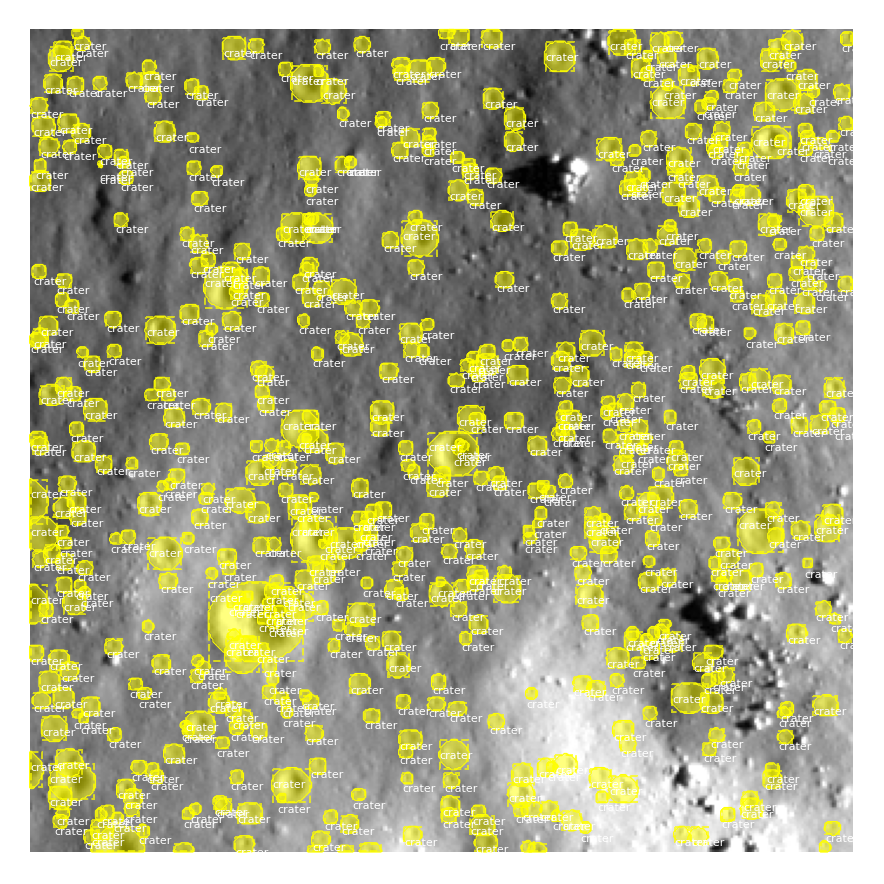

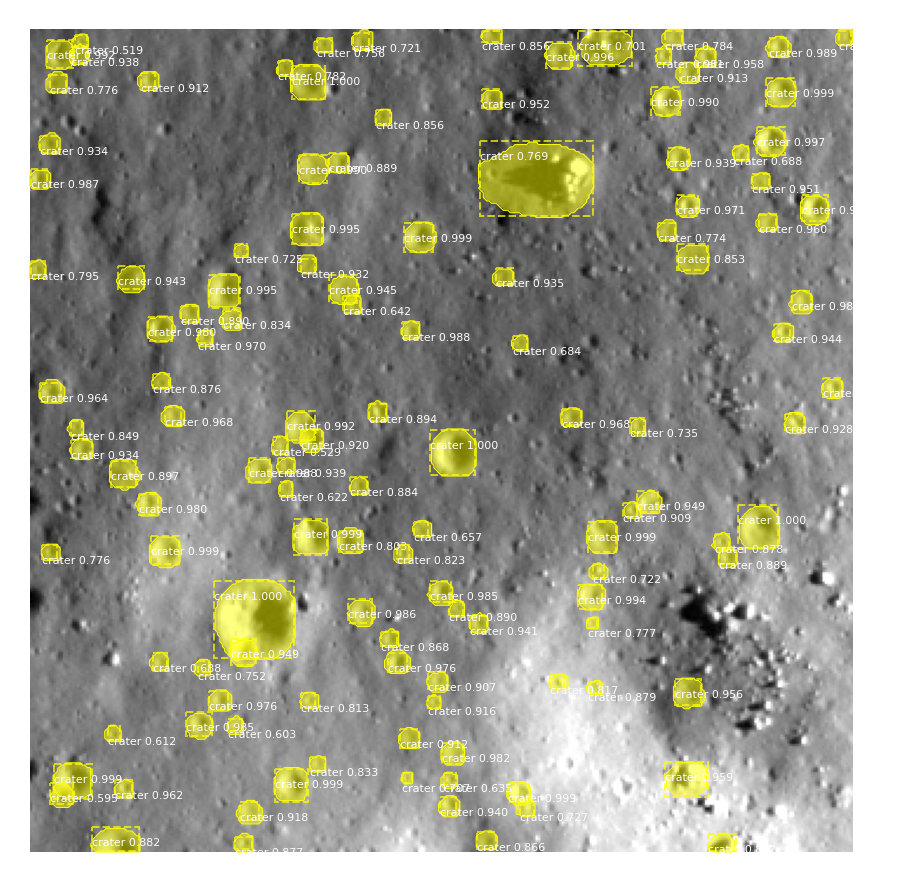

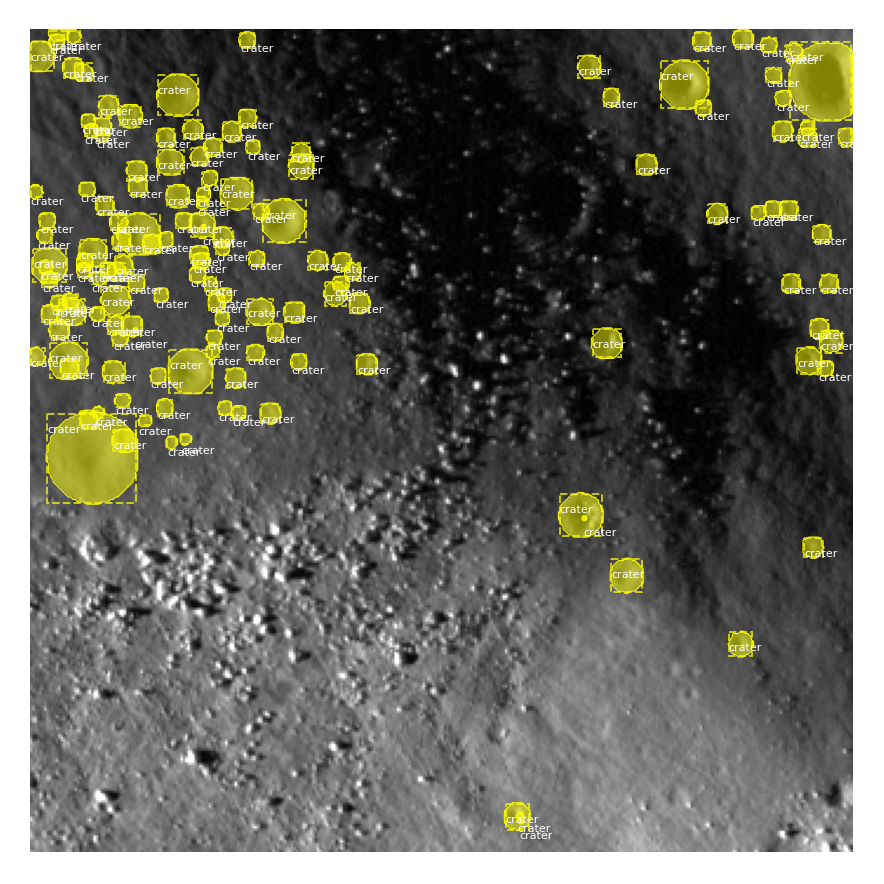

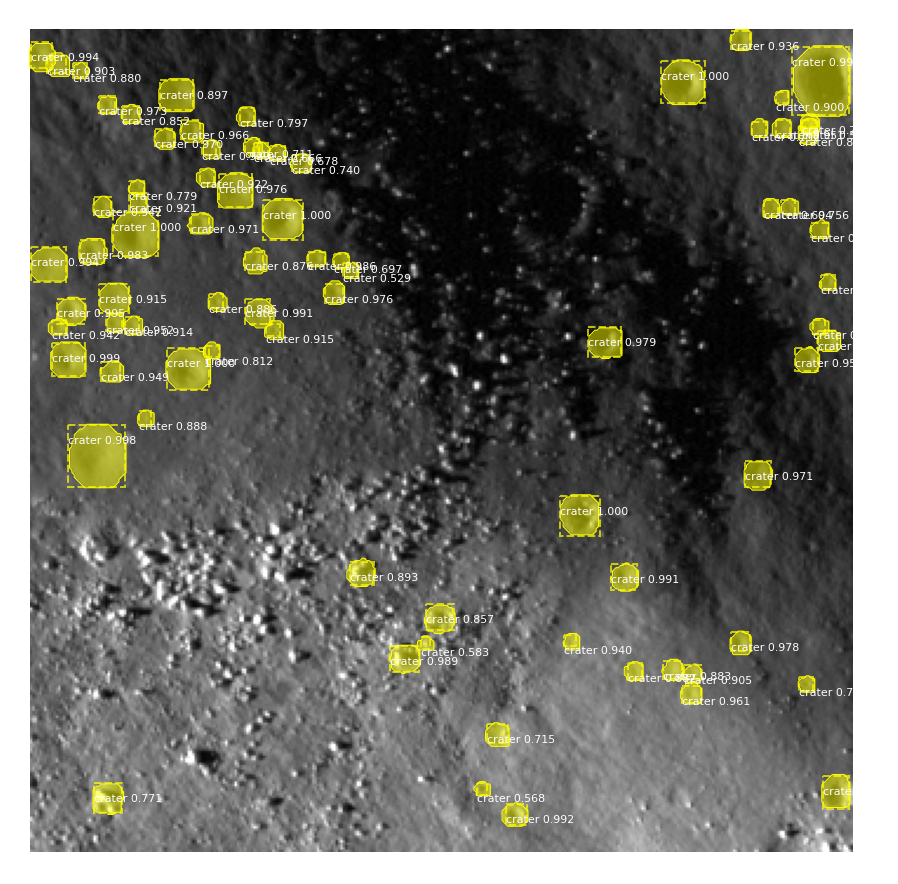

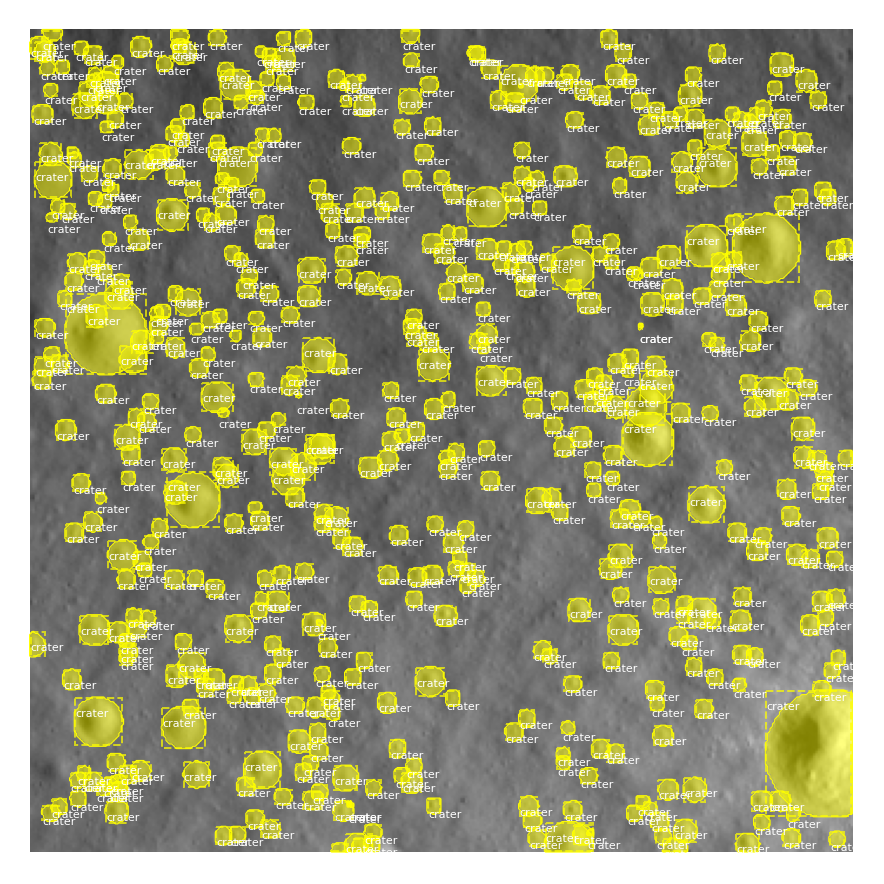

...

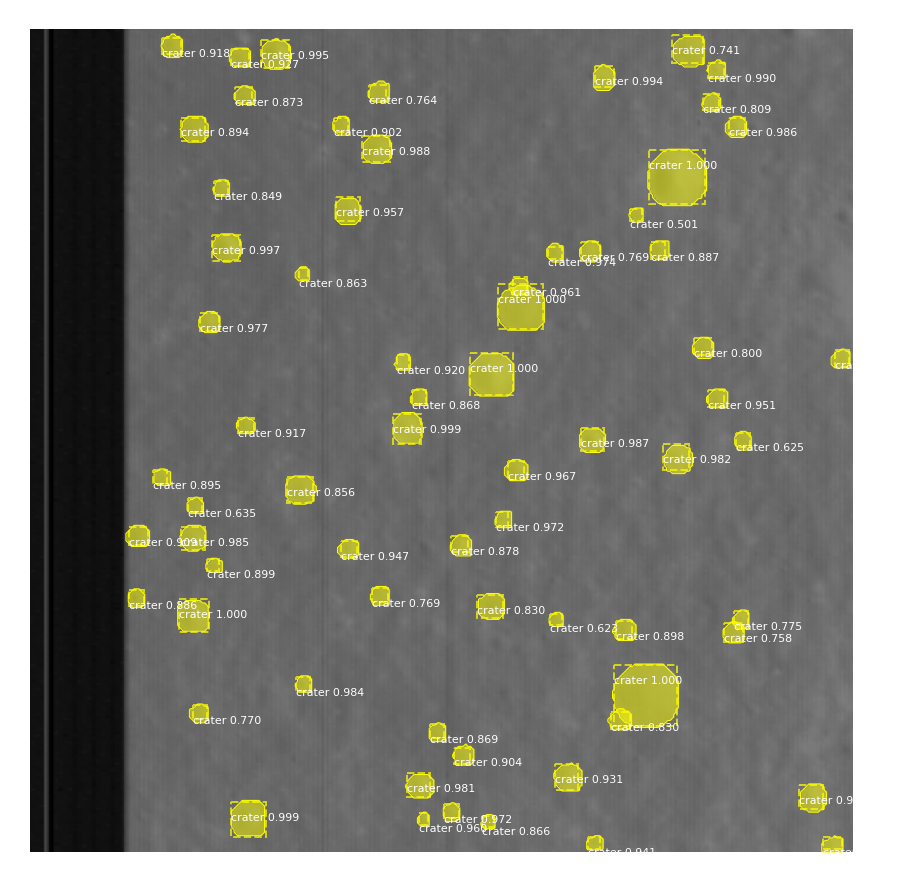

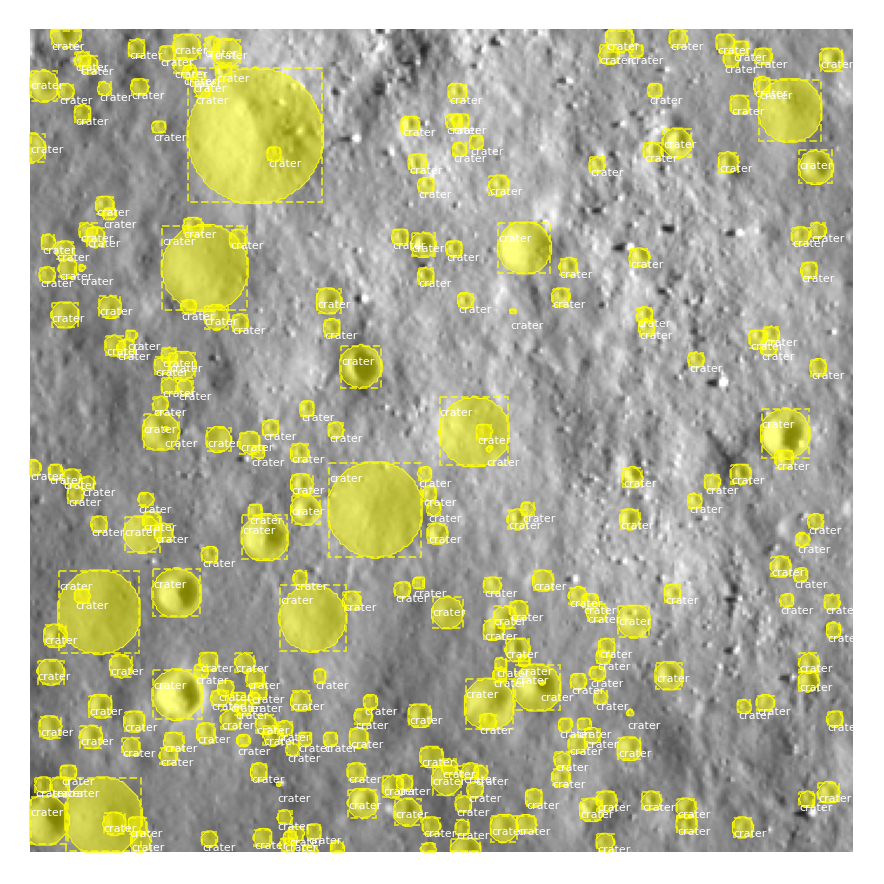

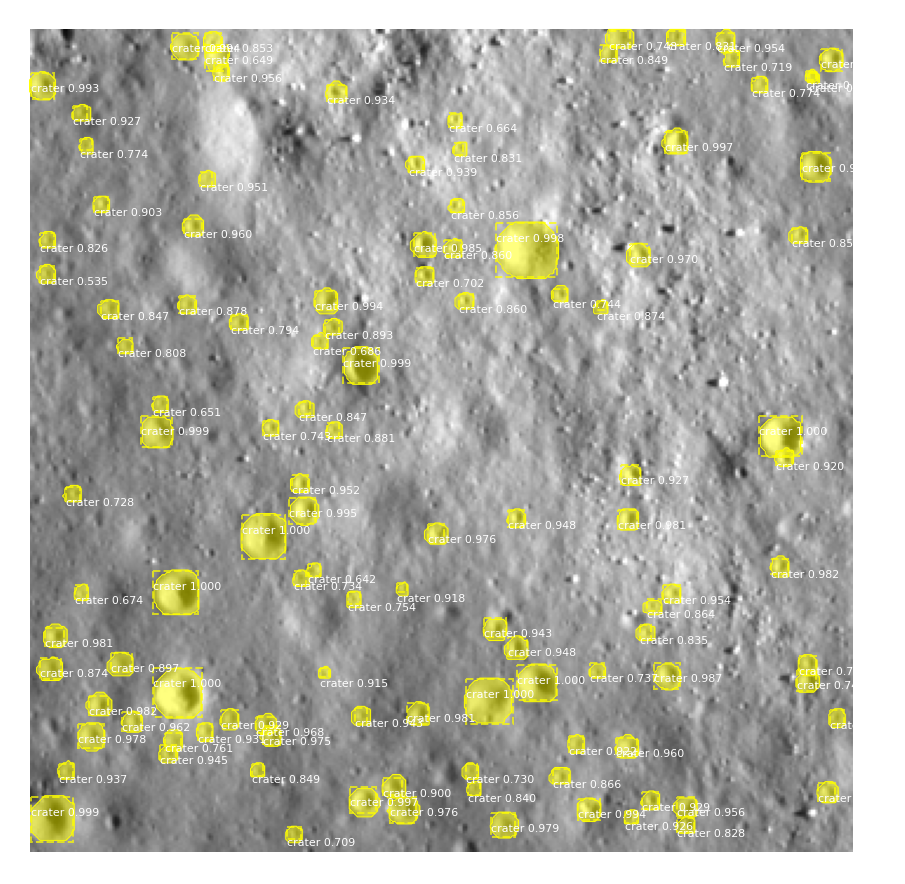

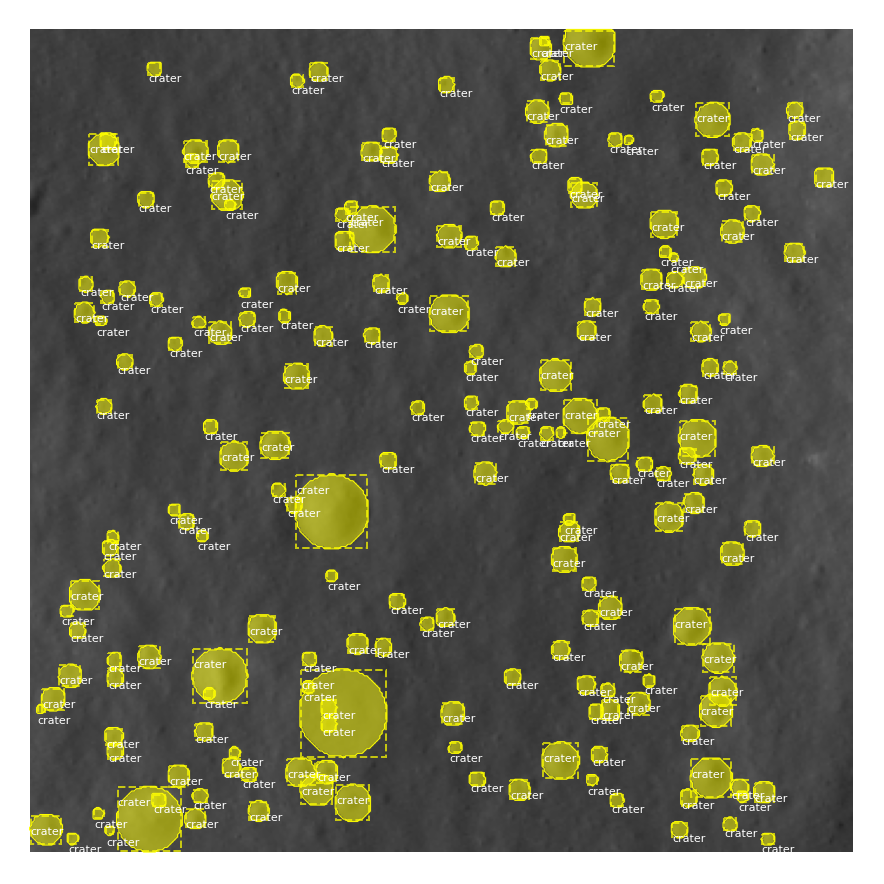

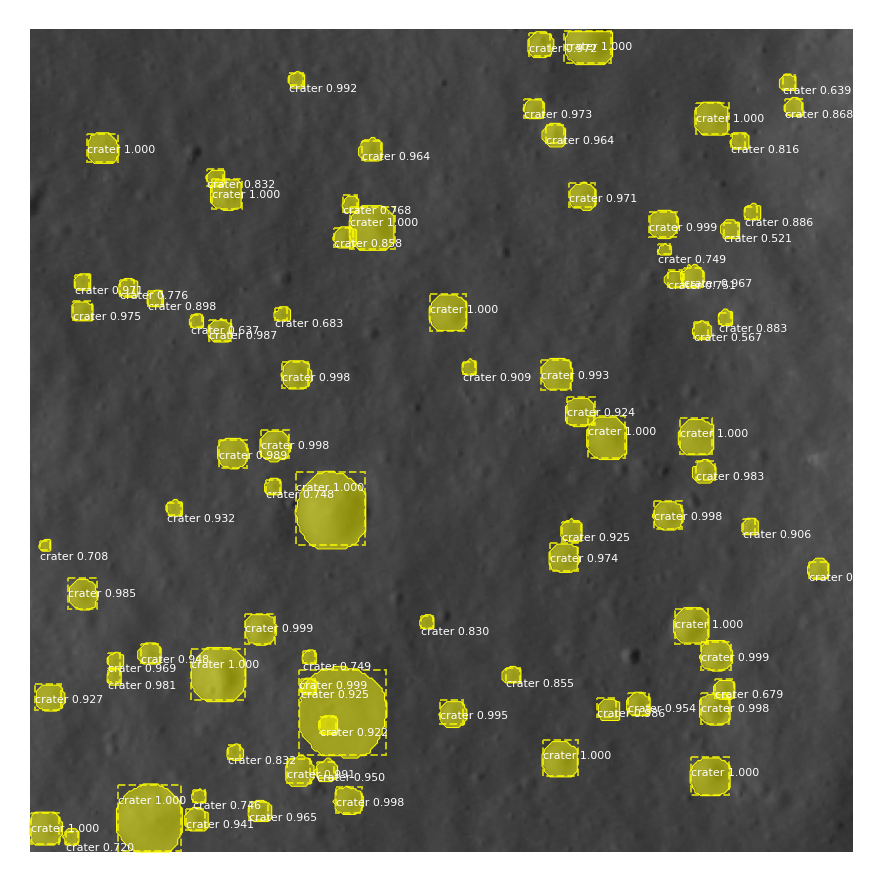

In [60]:
for i, data in enumerate(dataset_test):
    image, target = data
    pred = mask_rcnn(image.unsqueeze(0).to(device))[0]

    boxes = pred['boxes'].to("cpu").detach().numpy()
    labels = pred['labels'].to("cpu").detach().numpy()
    scores = pred['scores'].to("cpu").detach().numpy()
    masks = pred['masks'].to("cpu").detach().numpy()
    result = {}
    result['bb'] = boxes
    result['labels'] = labels
    result['scores'] = scores
    result['mask'] = masks

    visualize_result(mask_rcnn, data)
    # visualize_pred(image, pred)

